In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters)
from polyhedra import all_poly_types, poly_types

In [3]:
kdata = make_k(-67)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)

In [4]:
alphas = precomputed_alphas(k)
sigmas = singular_points(k)
assert sigmas == [inf]

M_alphas, alpha_inv = make_M_alphas(alphas)

In [5]:
polys, hemis = all_polyhedra(k)

New orbit from P_0=[-27/67*w + 47/67, 2/67]: {0}
New orbit from P_1=[27/67*w + 20/67, 2/67]: {1}
New orbit from P_2=[-26/67*w - 28/201, 20/603]: {2, 4, 6}
New orbit from P_3=[26/67*w + 28/201, 20/603]: {3, 5, 7}
New orbit from P_8=[-53/134*w + 23/201, 95/2412]: {17, 8, 10, 12, 15}
New orbit from P_9=[53/134*w - 23/201, 95/2412]: {16, 9, 11, 13, 14}
New orbit from P_18=[69/335*w + 133/335, 66/1675]: {18, 21}
New orbit from P_19=[-69/335*w + 202/335, 66/1675]: {19, 20}
New orbit from P_22=[31/134*w + 9/67, 11/268]: {24, 27, 22}
New orbit from P_23=[-31/134*w - 9/67, 11/268]: {25, 26, 23}
New orbit from P_28=[29/134*w + 62/201, 101/2412]: {32, 35, 36, 28, 31}
New orbit from P_29=[-29/134*w - 62/201, 101/2412]: {33, 34, 37, 29, 30}
New orbit from P_38=[16/67*w - 8/67, 3/67]: {38}
New orbit from P_39=[-16/67*w + 8/67, 3/67]: {39}
Found 14 orbits
Orbits:
[2, 4, 6]
[38]
[18, 21]
[24, 27, 22]
[25, 26, 23]
[16, 9, 11, 13, 14]
[39]
[33, 34, 37, 29, 30]
[3, 5, 7]
[1]
[17, 8, 10, 12, 15]
[32, 35, 

In [6]:
assert len(polys)==14

We should have 2 octahedra, 2 hexagonal caps, 4 triangular prisms, 4 square prisms, and 2 truncated tetrahedra

In [7]:
poly_types(polys)

{'tetrahedron': 0,
 'cube': 0,
 'octahedron': 2,
 'triangular prism': 4,
 'square prism': 4,
 'hexagonal prism': 0,
 'hexagonal cap': 2,
 'truncated tetrahedron': 2,
 'cuboctahedron': 0,
 'unknown': 0}

In [8]:
all_poly_types(polys)

['hexagonal cap',
 'triangular prism',
 'octahedron',
 'triangular prism',
 'triangular prism',
 'square prism',
 'triangular prism',
 'square prism',
 'hexagonal cap',
 'truncated tetrahedron',
 'square prism',
 'square prism',
 'octahedron',
 'truncated tetrahedron']

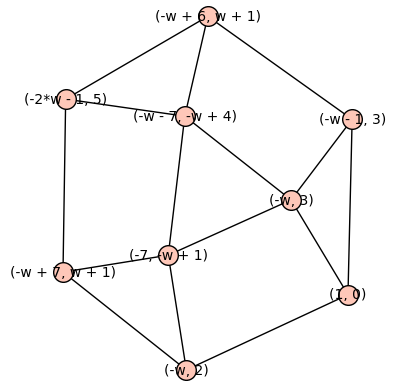

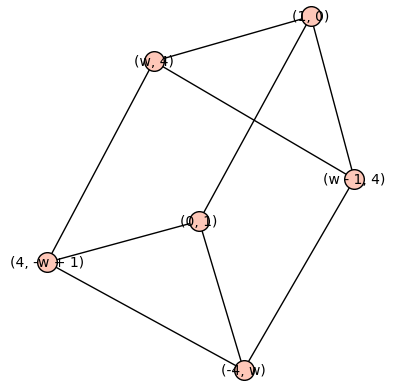

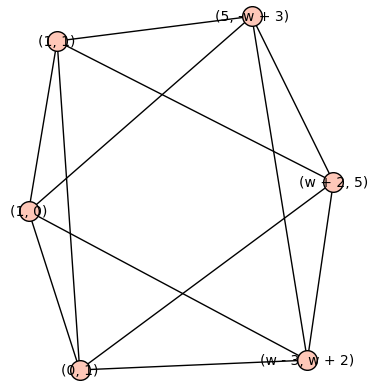

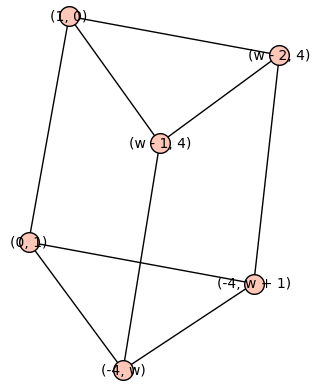

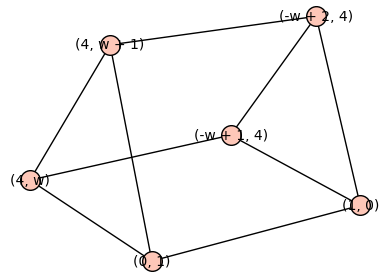

...

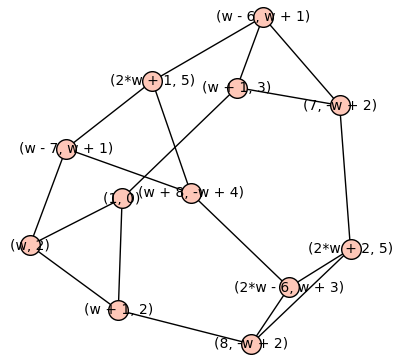

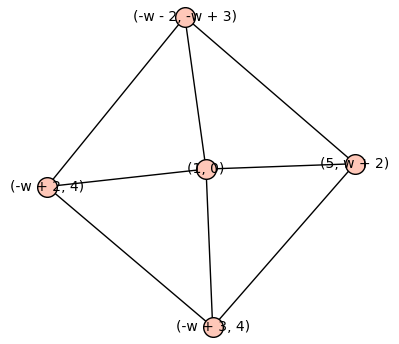

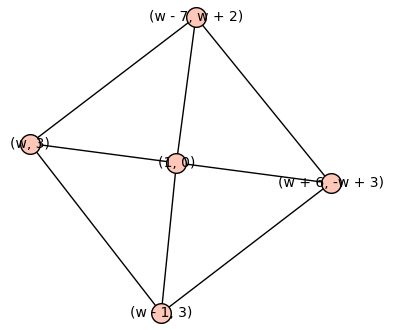

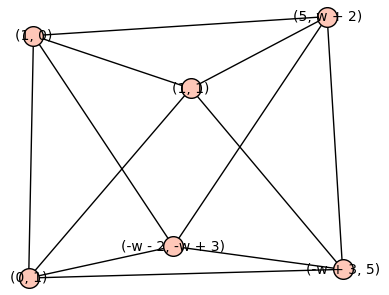

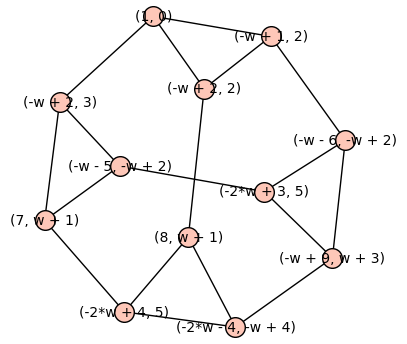

In [9]:
for G in polys: show(G) 

In [10]:
triangles = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
#aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [11]:
[len(t) for t in [aaa_triangles, squares, hexagons]]

[56, 22, 10]

In [12]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [13]:
[len(t) for t in [aaa_triangles0, squares0, hexagons0]]

[9, 3, 1]

In [14]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

67 Q 11 4 2 3 0 -1 0 0 0 0
67 Q 0 11 0 11 0 0 0 0 0 0
67 Q 14 8 13 0 -1 0 0 0 0 0


[[[11, 4, 2, 3], [-w, 0, 0]],
 [[0, 11, 0, 11], [0, 0, 0]],
 [[14, 8, 13, 0], [-1, 0, 0]]]

In [15]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[-w + 1:3], oo, [-w + 2:3]],
 [[-w:-4], oo, [-w + 1:-4]],
 [[w + 2:-w + 3], oo, [5:-w - 2]],
 [[w - 3:w + 2], oo, [0:1]],
 [[w:4], oo, [w + 1:4]],
 [[w - 3:w + 2], oo, [w + 1:4]],
 [[w + 6:-w + 3], oo, [w - 1:3]]]

In [16]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

67 T 5 8 6 1 0
67 T 9 11 9 0 0
67 T 19 24 2 -1 0
67 T 24 0 17 0 0
67 T 9 13 16 0 0
67 T 24 13 3 0 0
67 T 17 6 16 0 0


[[[5, 8, 6], 1],
 [[9, 11, 9], 0],
 [[19, 24, 2], -1],
 [[24, 0, 17], 0],
 [[9, 13, 16], 0],
 [[24, 13, 3], 0],
 [[17, 6, 16], 0]]

In [17]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object